In [2]:
import numpy as np 
import pandas as pd
import os
import matplotlib.pyplot as plt 
import seaborn as sns

In [4]:
data = pd.read_csv('/home/davi/Github/esquerta_centro_direita/archives/municipios_kmeans.csv').iloc[:,1:]
data

,UF,Nome_UF,Mesorregião,Nome_Meso,Microrregião,Nome_Micro,Município,Nome_Munic,siglas,espectro,...,PIA18M,POP,POPT,I_ESCOLARIDADE,I_FREQ_PROP,IDHM,IDHM_E,IDHM_L,IDHM_R,kmeans
0,11,Rondônia,1102,Leste Rondoniense,11006,Cacoal,1100015,Alta Floresta D'Oeste,RO,D,...,16431.0,24097,22429,0.368,0.629,0.641,0.526,0.763,0.657,0
1,11,Rondônia,1102,Leste Rondoniense,11003,Ariquemes,1100023,Ariquemes,RO,D,...,60213.0,89766,88730,0.514,0.648,0.702,0.600,0.806,0.716,0
2,11,Rondônia,1102,Leste Rondoniense,11008,Colorado do Oeste,1100031,Cabixi,RO,E,...,4306.0,6303,6156,0.357,0.700,0.650,0.559,0.757,0.650,0
3,11,Rondônia,1102,Leste Rondoniense,11006,Cacoal,1100049,Cacoal,RO,D,...,54356.0,78141,76876,0.488,0.698,0.718,0.620,0.821,0.727,0
4,11,Rondônia,1102,Leste Rondoniense,11008,Colorado do Oeste,1100056,Cerejeiras,RO,D,...,11786.0,16942,16815,0.430,0.712,0.692,0.602,0.799,0.688,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5531,52,Goiás,5205,Sul Goiano,52016,Pires do Rio,5222005,Vianópolis,GO,D,...,8914.0,12501,12445,0.432,0.747,0.712,0.622,0.818,0.710,0
5532,52,Goiás,5205,Sul Goiano,52015,Meia Ponte,5222054,Vicentinópolis,GO,C,...,5190.0,7288,7239,0.389,0.676,0.684,0.562,0.804,0.707,0
5533,52,Goiás,5204,Leste Goiano,52012,Entorno de Brasília,5222203,Vila Boa,GO,D,...,3065.0,4685,4531,0.431,0.594,0.647,0.534,0.818,0.619,0
5534,52,Goiás,5204,Leste Goiano,52012,Entorno de Brasília,5222302,Vila Propício,GO,E,...,3476.0,4739,4523,0.330,0.624,0.634,0.505,0.802,0.629,0


## Correlação

In [9]:
corr_ = []
for i in ['pearson', 'kendall', 'spearman']:
    corr_matrix = data.iloc[:,10:].corr(method=i).abs()
    sol = (corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool)).stack().sort_values(ascending=False))
    corr_.append(sol.head())

corr_

[T_LUZ       T_SLUZ        1.000000
 T_FREQ4A5   T_FORA4A5     1.000000
 T_FREQ6A14  T_FORA6A14    1.000000
 PESO18      PIA18M        0.999999
 pesotot     POP           0.999998
 dtype: float64,
 T_FREQ6A14   T_FORA6A14        1.000000
 T_LUZ        T_SLUZ            1.000000
 T_FREQ4A5    T_FORA4A5         1.000000
 PREN20RICOS  PREN80            0.999277
 T_FUND18M    I_ESCOLARIDADE    0.998780
 dtype: float64,
 T_FREQ6A14  T_FORA6A14        1.000000
 T_FREQ4A5   T_FORA4A5         1.000000
 T_LUZ       T_SLUZ            1.000000
 T_FUND18M   I_ESCOLARIDADE    0.999995
 RDPC        IDHM_R            0.999992
 dtype: float64]

In [10]:
# Características com máxima correlação

features = [
    sol[:3].index.to_numpy()[0][0],
    sol[:3].index.to_numpy()[0][1],
    sol[:3].index.to_numpy()[1][0],
    sol[:3].index.to_numpy()[1][1],
    sol[:3].index.to_numpy()[2][0],
    sol[:3].index.to_numpy()[2][1]]

features

['T_FREQ6A14', 'T_FORA6A14', 'T_FREQ4A5', 'T_FORA4A5', 'T_LUZ', 'T_SLUZ']

In [11]:
d = pd.concat([data.iloc[:,:10],data.loc[:,features],data['kmeans']],axis=1)
d

,UF,Nome_UF,Mesorregião,Nome_Meso,Microrregião,Nome_Micro,Município,Nome_Munic,siglas,espectro,T_FREQ6A14,T_FORA6A14,T_FREQ4A5,T_FORA4A5,T_LUZ,T_SLUZ,kmeans
0,11,Rondônia,1102,Leste Rondoniense,11006,Cacoal,1100015,Alta Floresta D'Oeste,RO,D,95.68,4.32,39.18,60.82,93.98,6.02,0
1,11,Rondônia,1102,Leste Rondoniense,11003,Ariquemes,1100023,Ariquemes,RO,D,97.21,2.79,55.34,44.66,98.58,1.42,0
2,11,Rondônia,1102,Leste Rondoniense,11008,Colorado do Oeste,1100031,Cabixi,RO,E,98.03,1.97,66.92,33.08,96.36,3.64,0
3,11,Rondônia,1102,Leste Rondoniense,11006,Cacoal,1100049,Cacoal,RO,D,97.61,2.39,62.41,37.59,98.89,1.11,0
4,11,Rondônia,1102,Leste Rondoniense,11008,Colorado do Oeste,1100056,Cerejeiras,RO,D,98.54,1.46,61.27,38.73,98.85,1.15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5531,52,Goiás,5205,Sul Goiano,52016,Pires do Rio,5222005,Vianópolis,GO,D,98.55,1.45,80.27,19.73,99.83,0.17,0
5532,52,Goiás,5205,Sul Goiano,52015,Meia Ponte,5222054,Vicentinópolis,GO,C,99.10,0.90,78.79,21.21,99.70,0.30,0
5533,52,Goiás,5204,Leste Goiano,52012,Entorno de Brasília,5222203,Vila Boa,GO,D,95.96,4.04,30.42,69.58,99.78,0.22,0
5534,52,Goiás,5204,Leste Goiano,52012,Entorno de Brasília,5222302,Vila Propício,GO,E,96.89,3.11,41.62,58.38,97.59,2.41,0


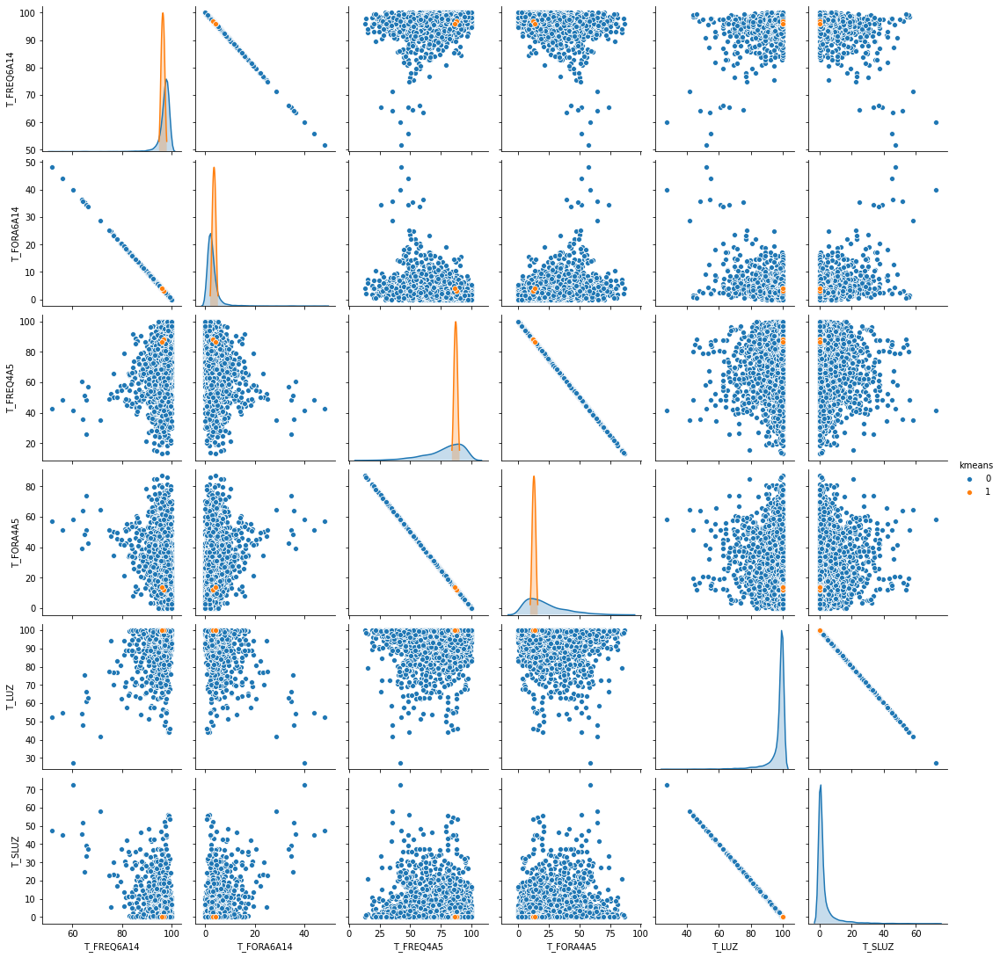

In [12]:
sns.pairplot(data=d.iloc[:,10:],hue='kmeans')

In [14]:
x = pd.ExcelFile('/home/davi/Github/esquerta_centro_direita/docs/atlas2013_dadosbrutos_pt.xlsx')
x

In [16]:
siglas = x.parse(x.sheet_names[0])
aux_index = [siglas[siglas['SIGLA']==features[i]] for i in range(len(features))]
pd.concat(aux_index)

,SIGLA,NOME CURTO,NOME LONGO,DEFINIÇÃO
49,T_FREQ6A14,% de 6 a 14 anos na escola,Taxa de atendimento escolar da população de 6 ...,Razão entre a população de 6 a 14 anos de idad...
147,T_FORA6A14,% de crianças de 6 a 14 fora da escola,% de crianças de 6 a 14 anos que não freque...,Razão entre as crianças de 6 a 14 anos que não...
45,T_FREQ4A5,% de 4 a 5 anos na escola,Taxa de atendimento escolar da população de 4 ...,Razão entre a população de 4 a 5 anos de idade...
146,T_FORA4A5,% de crianças de 4 a 5 anos fora da escola,% de crianças de 4 a 5 anos que não frequen...,Razão entre o número de crianças de 4 a 5 anos...
142,T_LUZ,% da população em domicílios com energia elétrica,Percentual da população que vive em domicílios...,Razão entre a população que vive em domicílios...
157,T_SLUZ,% de pessoas em domicílios sem energia elétrica,% de pessoas em domicílios sem energia elét...,Razão entre as pessoas que vivem em domicílios...
